In [92]:
import pandas as pd
import numpy as np
import datetime as dt
import seaborn as sns
import os
import matplotlib.pyplot as plt
import warnings
from sklearn.decomposition import PCA 
warnings.simplefilter(action='ignore', category=FutureWarning)
from sklearn.preprocessing import StandardScaler
from IPython.display import display
from pandas.tools.plotting import table
import matplotlib.ticker

In [67]:
sns.set_style('whitegrid')
sns.set_context('poster')
gender_palette = sns.color_palette(['#1258DC','#C21460']) # M F
geno_palette = sns.color_palette(['#8601AF','#FC600A']) # WT Df1
gengen_palette = sns.color_palette(['#8601AF','#FC600A','#C91BFE','#FE9F6D']) # WT_M Df1_M WT_F Df1_F
anim_palette = sns.color_palette(['#D84DFF','#C91BFE','#8601AF','#52006B','#FDBA96','#FE9F6D','#FC600A','#BF4503']) # RW7 RW8 RW9 RW10 RZ7 RZ8 RZ9 RZ10
specAnim_palette = sns.color_palette(['#305A30','#0A3409','#A70F01','#882216']) # RW9 RW10 RZ9 RZ10
bandAnim_palette = sns.color_palette(['#D84DFF','#FDBA96','#C91BFE','#FE9F6D','#8601AF','#FC600A','#52006B','#BF4503']) # RW7 RZ7 RW8 RZ8 RW9 RZ9 RW10 RZ10
epoch_palette = sns.color_palette(['#2E2FE3','#FB8604','#448D76']) # Baseline Saline Ketamine
state_palette = sns.color_palette(['#448D76','#FB8604','#EA202C'])
palDict = {'genotype':geno_palette,
           'gender': gender_palette,
           'geno_gender':gengen_palette,
           'animal':anim_palette,
           'epoch_name':epoch_palette,
           'spec_animal':specAnim_palette,
           'state_name':state_palette,
           'band_animal':bandAnim_palette}
groupOrders = {'genotype':['WT','Df1'],
               'gender':['M','F'],
               'geno_gender':['WT_M','Df1_M','WT_F','Df1_F'],
               'animal':['RW7','RW8','RW9','RW10','RZ7','RZ8','RZ9','RZ10'],
               'epoch_name':['Baseline','Saline','Ketamine'],
               'spec_animal':['RW9','RW10','RZ9','RZ10'],
               'state_name':['NREM','Rest','Active'],
               'band_animal':['RW7','RZ7','RW8','RZ8','RW9','RZ9','RW10','RZ10']}

In [82]:
def logMean(x):
    tmp = np.mean(x)
    return 10*np.log10(tmp)
def spec_plot(data,method,group,hue='state_name',asp=1.33,group_order=None,nBoot=1000,hue_order=None):
    if hue_order is None:
        hue_order = groupOrders[hue]
    if group_order is None:
        group_order = groupOrders[group]
    palette = palDict[hue]
    yCol = method+'_Power'
    if len(data[group].unique())>4:
        legend_y = 1.2
        cWrap=4
        shift = 0.9
    else:
        legend_y = 1.05
        cWrap=len(data[group].unique())
        shift = 0.8
    g = sns.FacetGrid(data=data,col=group,hue=hue,hue_order=hue_order,
                      margin_titles=True,
                      palette=palette,col_order=group_order,height=6,aspect=asp,col_wrap=cWrap)
    g = g.map(sns.lineplot,'frequency',yCol,sort=True,n_boot=nBoot,estimator=logMean,ci=68)
    plt.subplots_adjust(top=shift)
    g.fig.suptitle('Mean '+method+' Spectra')
    [plt.setp(ax.texts, text="") for ax in g.axes.flat]
    g.set_titles(row_template='{row_name}', col_template='{col_name}')
    g.set_axis_labels('','')
    g.fig.text(0.5,0,'Frequency (Hz)',ha='center',fontsize=24)
    g.fig.text(0,.5,method+' Power (dB)',rotation=90,va='center',fontsize=24)
    legend = plt.legend(loc='upper right', bbox_to_anchor=(1.1, legend_y),
                        ncol=1, fancybox=True, shadow=True,fontsize=18)
    g.despine()
    return g

In [68]:
specList = []
project_path = '/data/Projects/'
figure_dir = project_path+'rn_Schizophrenia_Project/SFN2018_Figures/'

for dirpath,dirnames,files in os.walk(project_path):
    for name in files:
        if name.endswith('sleepSpecMatrix.csv'):
            specList.append(os.path.join(dirpath+'/'+name))

In [76]:
exclusions = ('state_name=="Artifact"',
              'state_name=="Transition"',
              'state_name=="REM"',
              'animal=="RW9" and (state_name=="Active" or tetrode==6)', # allow Active in trace plots
              'animal=="RW7" and day==5',
              'animal=="RZ7" and day==3',
              'animal=="RZ9" and day==5 and tetrode==8',
              'epoch_name=="Home"')
qStr = 'not ('+') and not ('.join(exclusions)+')'
traceExclusions = ('state_name=="Artifact"',
              'animal=="RW9" and tetrode==6', # allow Active, REM and Transition in trace plots
              'animal=="RW7" and day==5',
              'animal=="RZ7" and day==3',
              'animal=="RZ9" and day==5 and tetrode==8',
              'epoch_name=="Home"',
              'gender=="F"')
tqStr = 'not ('+') and not ('.join(traceExclusions)+')'

In [7]:
# Get data from CSV, add columns
specMat = pd.DataFrame()
for rf in specList:
    tmp = pd.read_csv(rf)
    specMat = specMat.append(tmp)
specMat = specMat.reset_index(drop=True)
print('Data Loaded!')
# Change Epoch Names (Baseline, Saline, Ketamine, Home)
# Change Band Names (Delta, Theta)
epochDict = {'Sleep':'Baseline','Saline':'Saline','Ketamine':'Ketamine','Home':'Home'}
specMat['epoch_name'] = specMat['epoch_type'].map(epochDict)

# Make geno_gender column
specMat['geno_gender'] = specMat['genotype'].map(str) + '_' + specMat['gender']
# Add state names
stateDict = {1:'REM',2:'NREM',3:'Rest',4:'Active',5:'Transition',6:'Artifact'}
specMat['state_name']=specMat['sleep_state'].map(stateDict)

Data Loaded!


In [8]:
def rolling_avg(data,win=31):
    data = data.sort_values(by=['epoch_time'])
    if win % 2 == 0:
        win+=1
    shift = round(win/2)-1
    rows = data.shape[0]
    start = shift
    end = rows-shift
    output = pd.DataFrame()
    for idx in np.arange(start,end,1):
        tmp = data.iloc[idx-shift:idx+shift]
        if len(tmp['state_name'].unique())==1:
            newRow = tmp.groupby(['animal','genotype','gender','geno_gender','state_name']).mean()
            output = output.append(newRow)
    return output.reset_index()

In [9]:
freq = np.sort(specMat['frequency'].unique())
f1 = ['%.1f' % number for number in freq]
f2 = [x.replace('.2','.25').replace('.8','.75') for x in f1]
def prinComp(data):
    state = data['state_name'].unique()[0]
    pdat = np.abs(data.loc[:,f2].values)
    #pdat = StandardScaler().fit_transform(pdat)
    pca = PCA(n_components=5,svd_solver='full')
    principalComponents = pca.fit_transform(pdat)
    pcCols = ['PC ' + y for y in ['%i' % x for x in (np.arange(principalComponents.shape[1])+1)]]
    principalDf = pd.DataFrame(data = principalComponents, columns = pcCols)
    data = data.reset_index(drop=True)
    df = pd.concat([data,principalDf],axis=1)
    weights = pd.DataFrame(data=np.matrix.transpose(pca.components_),index=freq,columns=pcCols)
    weights['state_name']=state
    exVar = pd.DataFrame(data=100*pca.explained_variance_ratio_,index=pcCols).reset_index().rename(columns={'index':'PC',0:'Percent Explained Variance'})
    exVar['state_name']=state
    return df,weights.reset_index().rename(columns={'index':'Frequency'}),exVar

In [10]:
# Pivot to have frequency bin columns
specTable = pd.DataFrame(specMat.pivot_table(index=['animal','genotype','gender','geno_gender','day','epoch','tetrode','state_name','epoch_time'],columns='frequency',values='CWT_Power').to_records())
specTable = specTable.sort_values(by=['animal','day','epoch','tetrode','epoch_time'])

In [11]:
specTable.head()

,animal,genotype,gender,geno_gender,day,epoch,tetrode,state_name,epoch_time,0.0,...,27.75,28.0,28.25,28.5,28.75,29.0,29.25,29.5,29.75,30.0
1784,RW10,WT,M,WT_M,1,1,1,Transition,1,95614.6296,...,588.3175,576.4606,564.6037,552.7468,540.8899,529.0329,527.3590,527.1072,526.8553,526.6035
1785,RW10,WT,M,WT_M,1,1,1,Transition,3,1258.7887,...,948.6164,963.4176,978.2187,993.0199,1007.8211,1022.6222,1000.8771,974.0280,947.1788,920.3296
1786,RW10,WT,M,WT_M,1,1,1,Transition,5,540.5216,...,560.0709,541.1392,522.2075,503.2758,484.3441,465.4123,457.1381,450.3523,443.5664,436.7806
1787,RW10,WT,M,WT_M,1,1,1,Transition,7,16045.0388,...,1188.7561,1180.7289,1172.7017,1164.6746,1156.6474,1148.6203,1134.7769,1120.1213,1105.4657,1090.8100
1788,RW10,WT,M,WT_M,1,1,1,Transition,9,3867.3079,...,700.5226,680.7064,660.8901,641.0739,621.2577,601.4415,592.0248,584.0605,576.0963,568.1320


In [79]:
plotSpec = specMat.query(qStr)
plotDat = plotSpec.groupby(['animal','genotype','gender','geno_gender','day','state_name']).mean()

In [79]:
plotDat = plotDat.reset_index()

In [12]:
tmp = specTable.query('animal=="RW10" and day==1 and epoch==1 and tetrode==1').sort_values(by=['epoch_time'])
ra = rolling_avg(tmp)

In [13]:
# Get rolling average, dropping states than are less than 60sec long
avgSpecTable = specTable.groupby(['animal','genotype','gender','geno_gender','day','epoch','tetrode']).apply(rolling_avg).reset_index(drop=True)

In [69]:
# Exclude
specDat = avgSpecTable.query(qStr)
specDat = specDat.reset_index(drop=True)
specDat.head()

,animal,genotype,gender,geno_gender,state_name,day,epoch,tetrode,epoch_time,0.0,...,27.75,28.0,28.25,28.5,28.75,29.0,29.25,29.5,29.75,30.0
0,RW10,WT,M,WT_M,Rest,1,1,1,52,10685.385447,...,774.567347,765.402733,756.238117,747.073527,737.908917,728.744320,723.458450,718.714297,713.970140,709.225967
1,RW10,WT,M,WT_M,Rest,1,1,1,54,10710.023630,...,767.619063,757.540327,747.461590,737.382877,727.304143,717.225423,711.802147,707.029063,702.255977,697.482877
2,RW10,WT,M,WT_M,Rest,1,1,1,152,7067.194880,...,888.328313,885.762827,883.197363,880.631890,878.066413,875.500943,872.856357,870.200723,867.545113,864.889493
3,RW10,WT,M,WT_M,Rest,1,1,1,154,7822.113157,...,892.584203,889.048937,885.513697,881.978443,878.443187,874.907937,871.826363,868.808153,865.789967,862.771763
4,RW10,WT,M,WT_M,Rest,1,1,1,156,7748.988657,...,875.481067,872.856670,870.232300,867.607917,864.983530,862.359147,859.677603,856.988083,854.298587,851.609067


In [110]:
# Average over tetrodes
avgDat = specDat.groupby(['animal','genotype','gender','geno_gender','day','epoch','state_name','epoch_time']).mean().reset_index().drop('tetrode',axis=1).sort_values(by=['animal','day','epoch','epoch_time'])
stateCounts = avgDat.groupby(['animal','state_name'])['state_name'].count()
minCounts = {}
for state in avgDat['state_name'].unique():
    minCounts[state]=min(stateCounts[:,state])

# Pick same number of samples from each animal for each state
sampSet = pd.DataFrame()
for name, tmp in avgDat.groupby(['animal','state_name']):
    n_samp = minCounts[name[1]]
    sampSet = sampSet.append(tmp.sample(n_samp))
sampSet = sampSet.sort_values(by=['animal','day','epoch_time'])

In [111]:
# Compute PCs and get Weights
pcaDat = pd.DataFrame()
pcaWeights = pd.DataFrame()
explainedVar = pd.DataFrame()

for name, data in sampSet.groupby('state_name'):
    comps, weights, exVar = prinComp(data)
    pcaDat = pcaDat.append(comps)
    pcaWeights = pcaWeights.append(weights)
    explainedVar = explainedVar.append(exVar)
pcaDat = pcaDat.reset_index(drop=True)
pcaWeights = pcaWeights.reset_index(drop=True)
explainedVar = explainedVar.reset_index(drop=True)

Percent Explained Variance                                         
PC                               PC 1       PC 2      PC 3      PC 4      PC 5
state_name                                                                    
Active                      61.344010  26.304974  6.188493  2.916713  1.374201
NREM                        78.650207  14.135159  3.230800  1.589916  0.722046
Rest                        76.110480  14.302709  5.344026  1.534772  0.848018

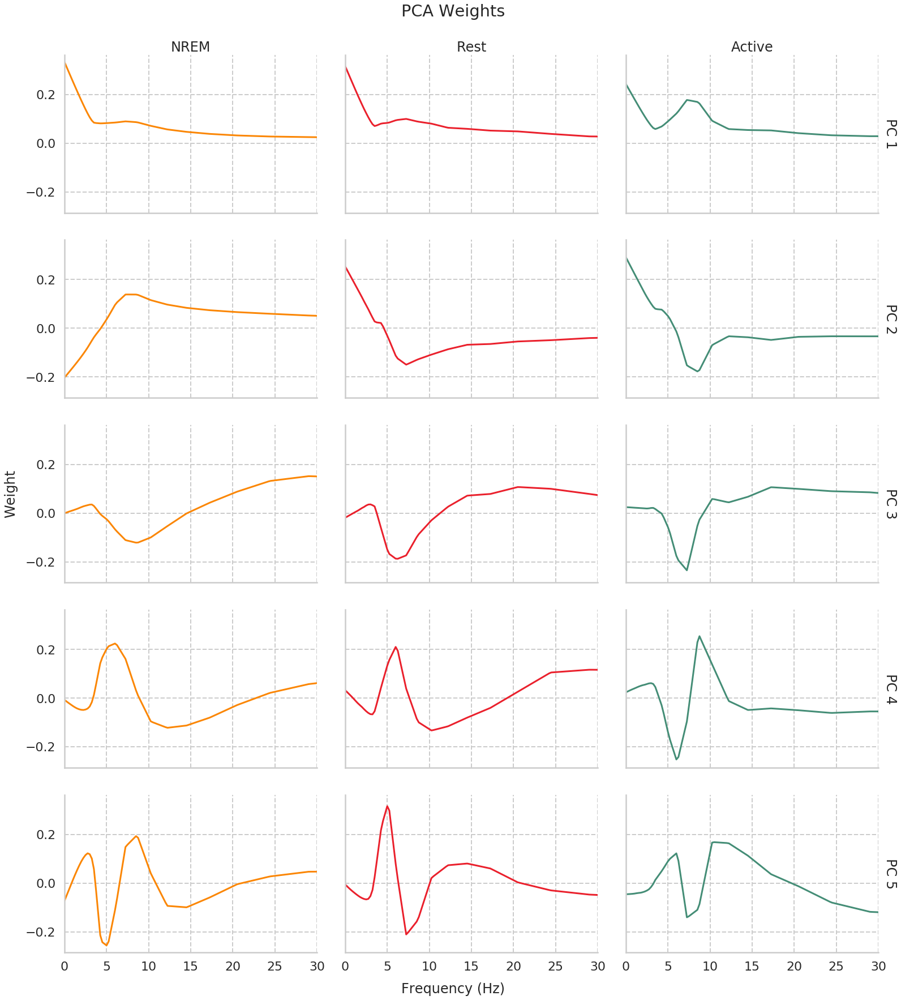

In [112]:
# Plot PCA Weights for each state
sns.set_style('whitegrid',{
    "ytick.major.size": 0.1,
    "xtick.major.size": 5,
    'grid.linestyle': '--'
})
weightDF = pd.melt(pcaWeights,id_vars=['Frequency','state_name'],value_vars=['PC 1','PC 2','PC 3','PC 4','PC 5'],var_name='PC',value_name='Weight')
g = sns.FacetGrid(data=weightDF,row='PC',col='state_name',height=5,aspect=1.5,margin_titles=True,col_order=groupOrders['state_name'],hue='state_name',palette=palDict['state_name'])
g = g.map(sns.lineplot,'Frequency','Weight')
plt.subplots_adjust(top=0.93)
g.fig.suptitle('PCA Weights')
[plt.setp(ax.texts, text="") for ax in g.axes.flat]
g.set_titles(row_template='{row_name}', col_template='{col_name}')
g.set_axis_labels('','')
g.fig.text(0.01,0.5,'Weight',rotation=90,va='center',fontsize=24)
g.fig.text(0.5,0.01,'Frequency (Hz)',ha='center',fontsize=24)
[ax.set_xlim(0,30) for ax in g.axes.flat]
g.despine()
exTable = explainedVar.pivot_table(columns='PC',index='state_name')
g.savefig(figure_dir+'PCA/PCA_Weights_raw.svg',format='svg')
display(exTable)
exTable.to_html(figure_dir+'PCA/PCA_ExplainedVariance_raw.html')

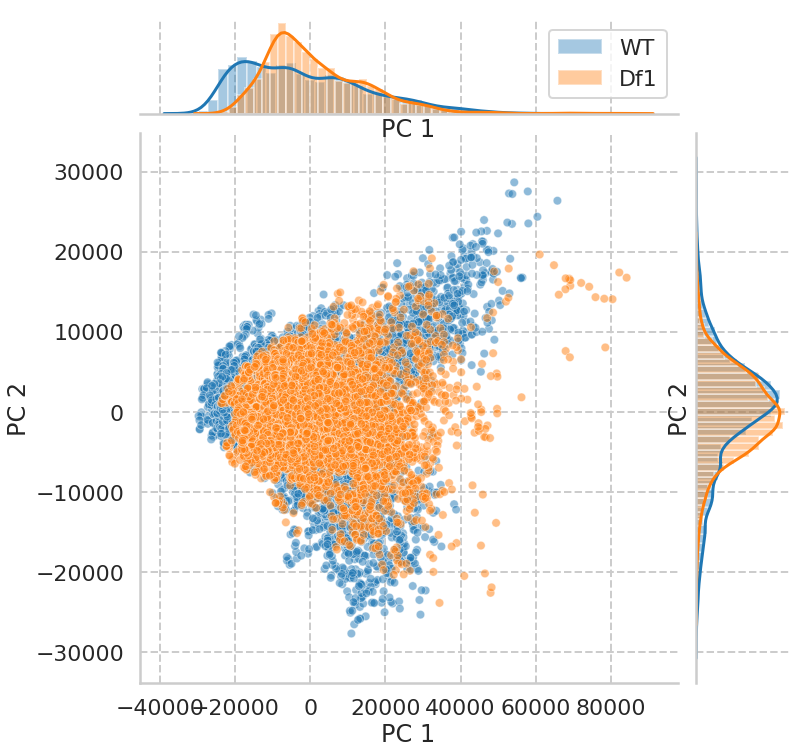

In [18]:
# Plot PCs and Color by Genotype
tmp = pcaDat.query('state_name=="NREM"')
g = sns.JointGrid(x=tmp['PC 1'],y=tmp['PC 2'],height=11)
sns.scatterplot(ax=g.ax_joint,data=tmp,x='PC 1',y='PC 2',hue='genotype',alpha=.5,size=1,legend=False)
sns.distplot(ax=g.ax_marg_x,a=tmp.query('genotype=="WT"')['PC 1'],kde=True,label='WT')
sns.distplot(ax=g.ax_marg_x,a=tmp.query('genotype=="Df1"')['PC 1'],kde=True,label='Df1')
sns.distplot(ax=g.ax_marg_y,a=tmp.query('genotype=="WT"')['PC 2'],vertical=True)
sns.distplot(ax=g.ax_marg_y,a=tmp.query('genotype=="Df1"')['PC 2'],vertical=True)
g.ax_marg_x.legend()

In [19]:
def pca_plot(data,x,y,group):
    group_order = groupOrders[group]
    palette = palDict[group]
    g = sns.JointGrid(x=data[x],y=data[y],height=11)
    sns.scatterplot(ax=g.ax_joint,data=data,x=x,y=y,hue=group,alpha=.5,size=1,legend=False,palette=palette,hue_order=group_order)
    for idx, elem in enumerate(group_order):
        sns.distplot(ax=g.ax_marg_x,a=data.query(group+'=="'+elem+'"')[x],label=elem,color=palette[idx],hist=False,axlabel=None)
        sns.distplot(ax=g.ax_marg_y,a=data.query(group+'=="'+elem+'"')[y],vertical=True,color=palette[idx],hist=False,axlabel=None)
    g.ax_marg_x.legend(loc='right', bbox_to_anchor=(1.25, 0),
                        ncol=1, fancybox=True, shadow=True,fontsize=18)
    g.ax_marg_x.set_xlabel('')
    g.ax_marg_y.set_ylabel('')
    g.ax_marg_x.set_zorder(1)
    g.fig.suptitle('PCA by ' + group.capitalize())
    return g


/home/roshan/.local/lib/python3.5/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


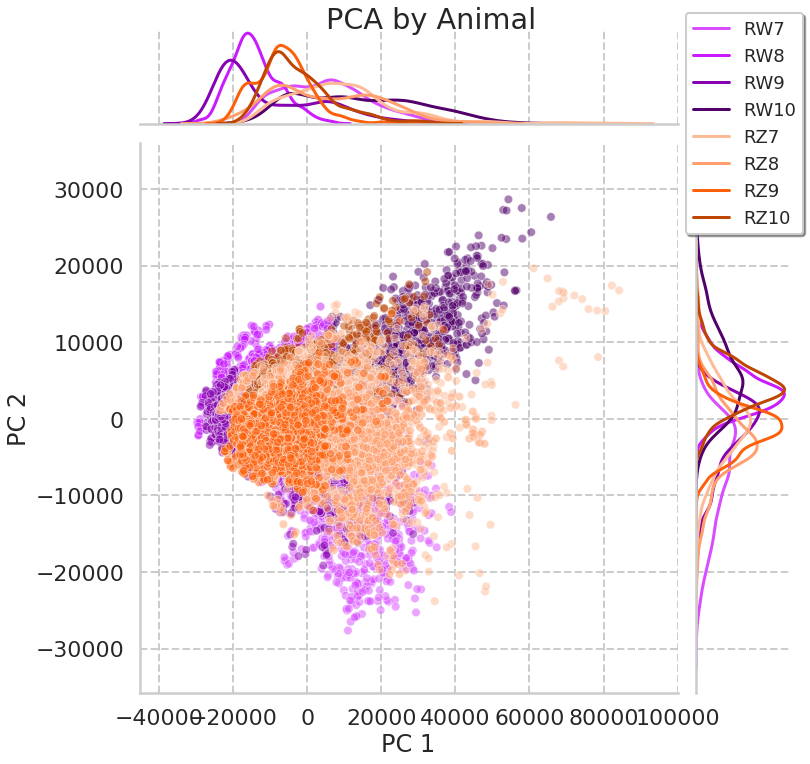

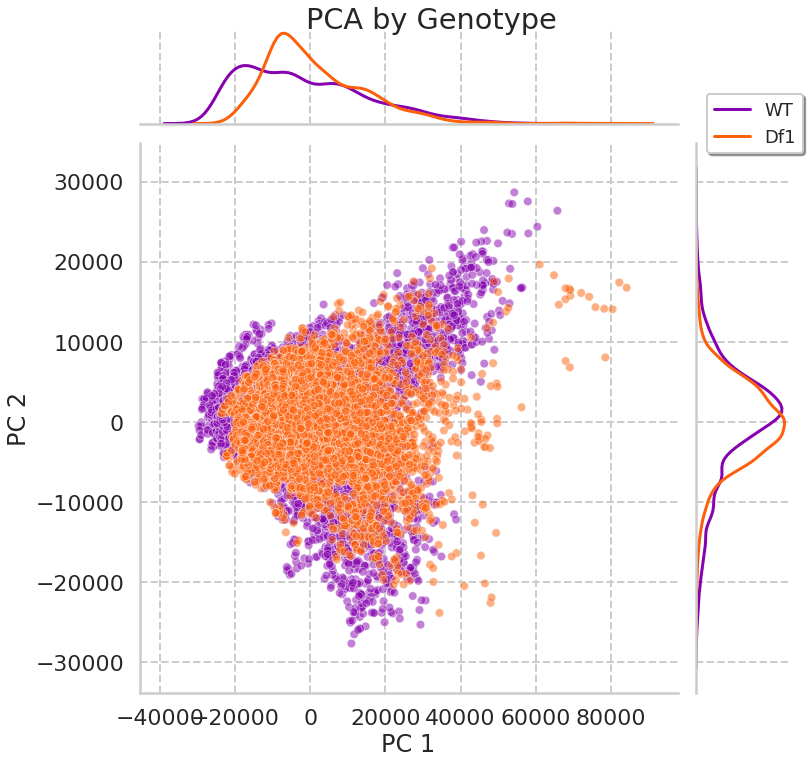

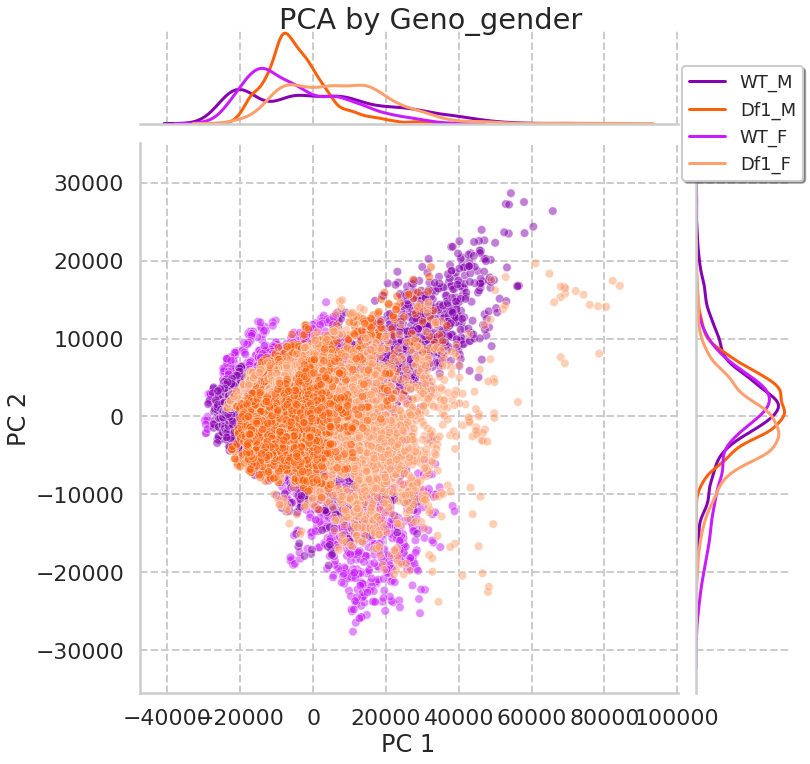

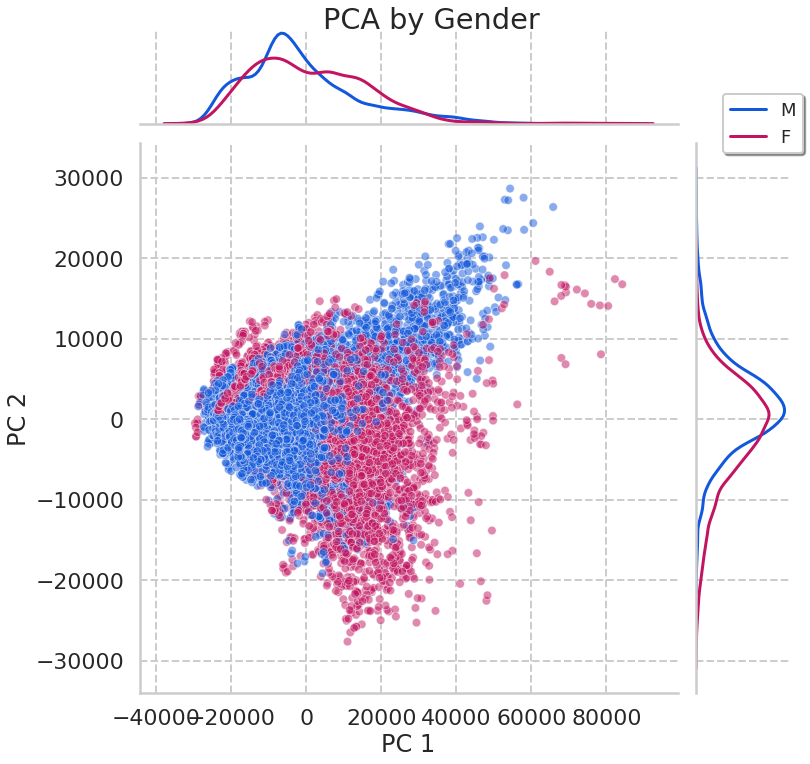

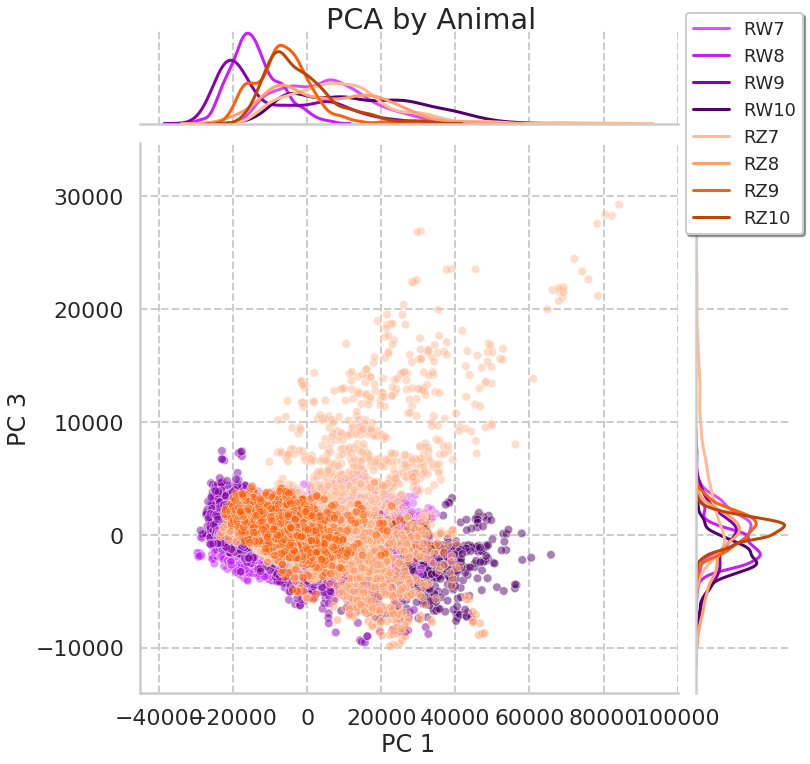

...

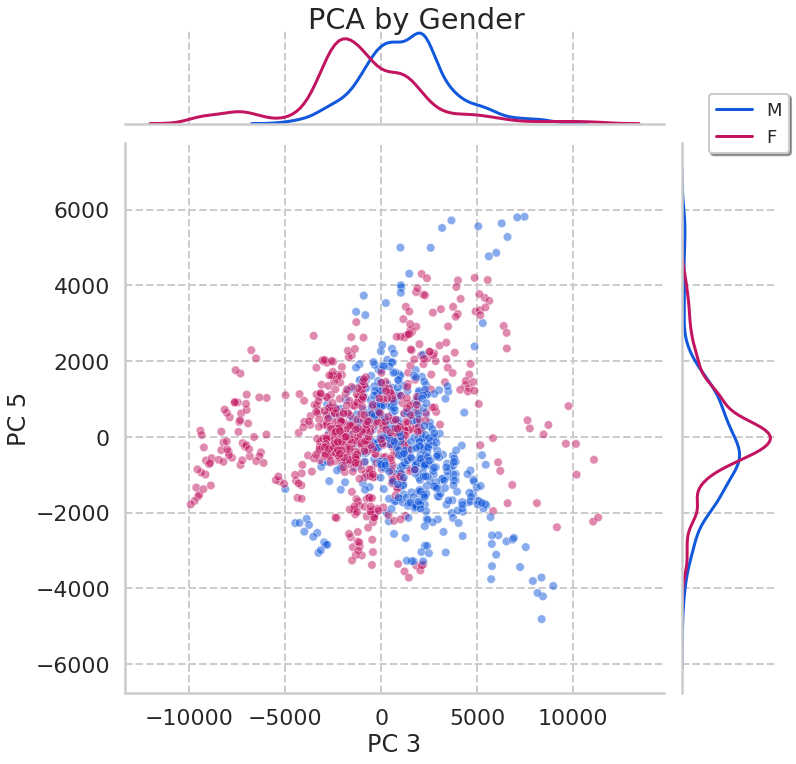

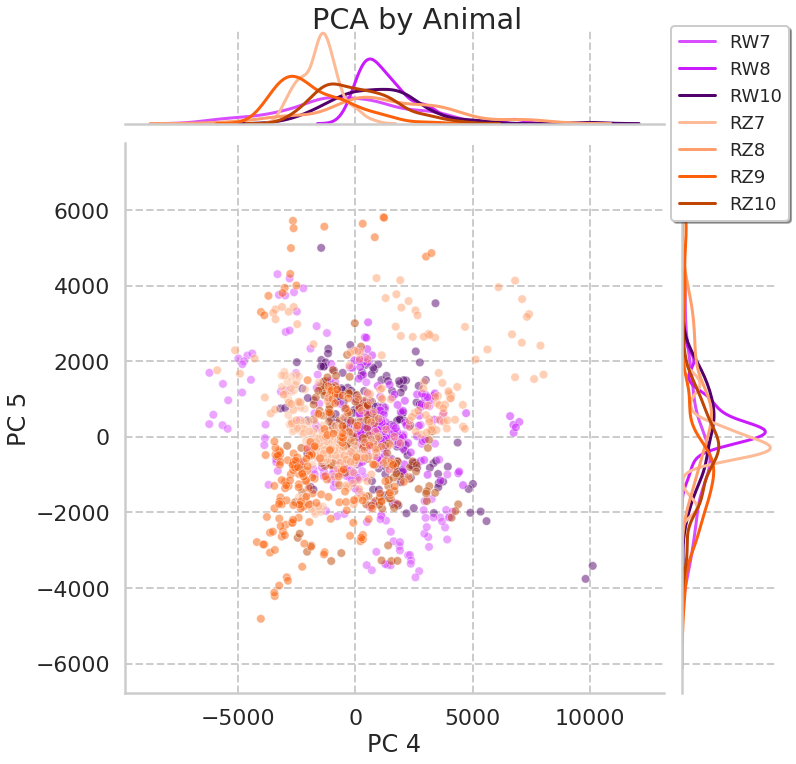

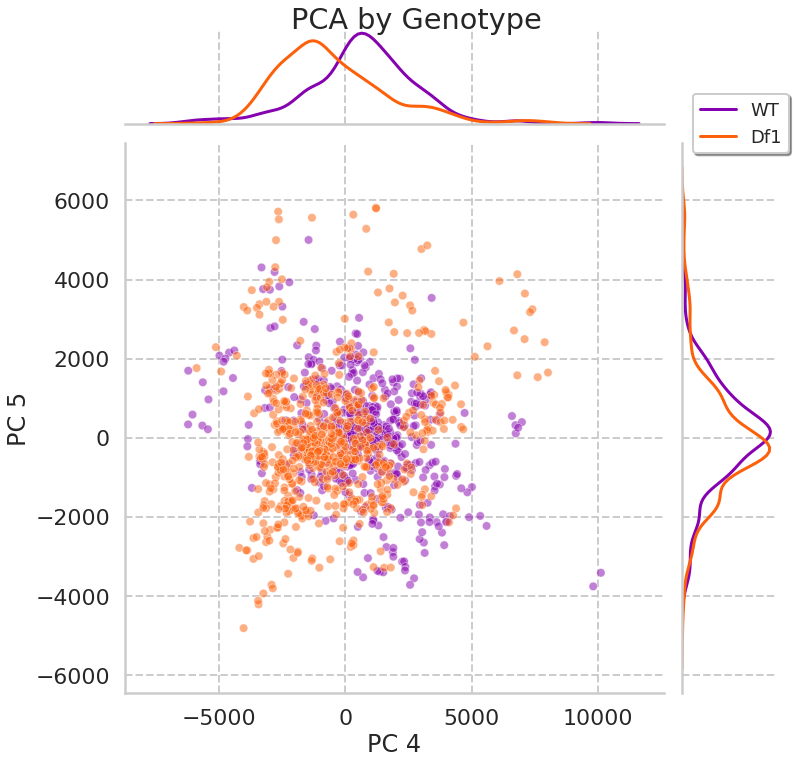

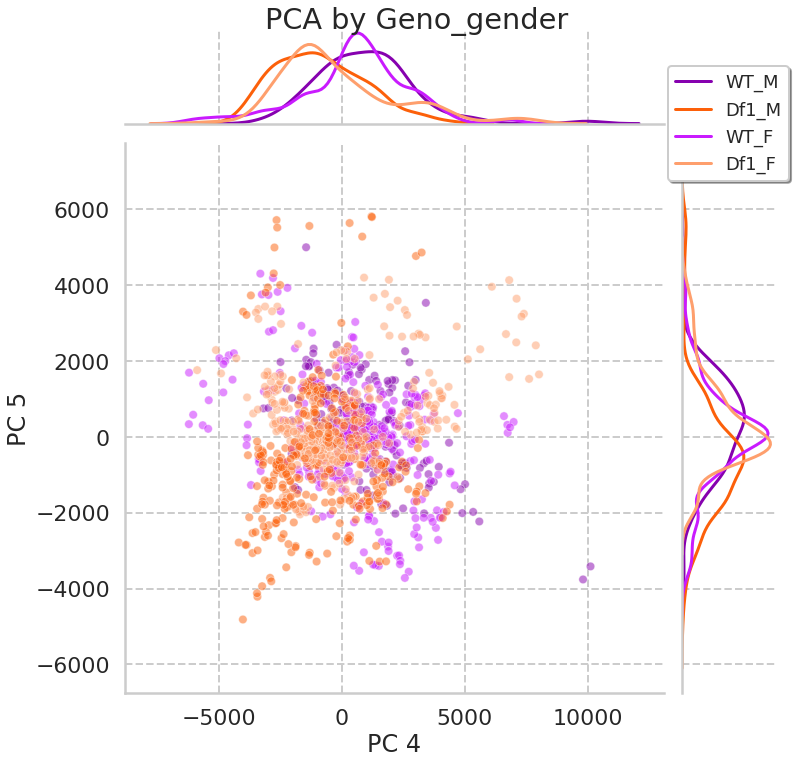

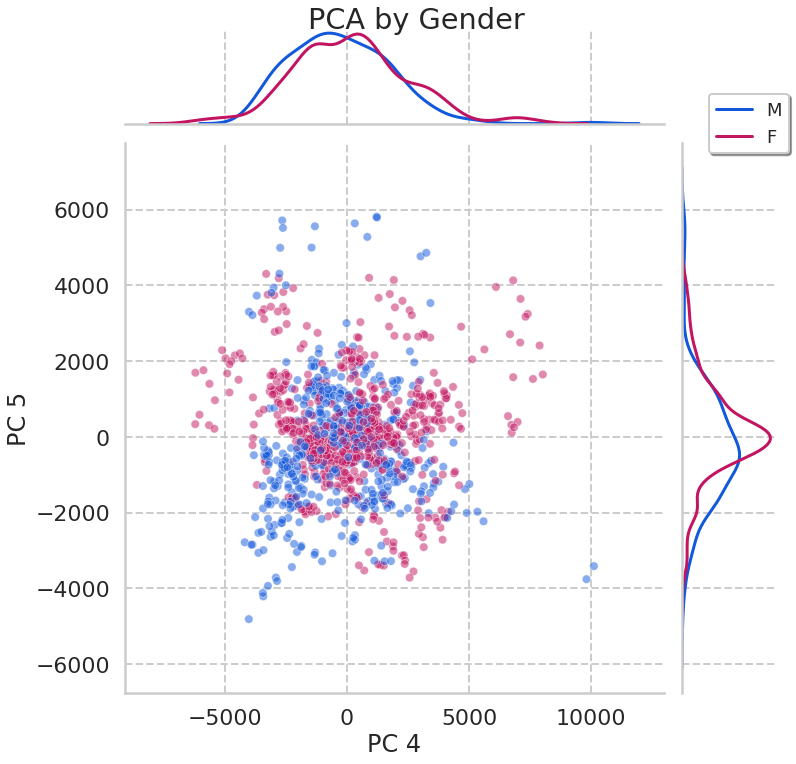

In [20]:
groups = ['animal','genotype','geno_gender','gender']
states = ['NREM','Rest','Active']
pairs = [(1,2),(1,3),(1,4),(1,5),(2,3),(2,4),(2,5),(3,4),(3,5),(4,5)]
for state in states:
    for pair in pairs:
        ps = ['%i' % x for x in pair]
        for group in groups:
            g = pca_plot(pcaDat.query('state_name=="'+state+'"'),'PC '+ps[0],'PC '+ps[1],group)
            g.savefig(figure_dir+'PCA/PCA-'+ps[0]+'x'+ps[1]+'_'+state+'_by_'+group+'_raw.svg')

In [21]:
# Explore PCA space
## for each animal, plot tetrodes on prin comps
## for each animal, plot days on prin comps
## plot each animal on prin comps
## plot each gender on prin comps
## plot each geno x gender on prin comps
## plot each 

In [83]:
def logMean(x):
    tmp = np.mean(x)
    return 10*np.log10(tmp)
def spec_plot(data,method,group,hue='state_name',asp=1.33,group_order=None,nBoot=1000,hue_order=None):
    if hue_order is None:
        hue_order = groupOrders[hue]
    if group_order is None:
        group_order = groupOrders[group]
    palette = palDict[hue]
    yCol = method+'_Power'
    if len(data[group].unique())>4:
        legend_y = 1.2
        cWrap=4
        shift = 0.9
    else:
        legend_y = 1.05
        cWrap=len(data[group].unique())
        shift = 0.8
    g = sns.FacetGrid(data=data,col=group,hue=hue,hue_order=hue_order,
                      margin_titles=True,
                      palette=palette,col_order=group_order,height=6,aspect=asp,col_wrap=cWrap)
    g = g.map(sns.lineplot,'frequency',yCol,sort=True,n_boot=nBoot,estimator=logMean,ci=68)
    [ax.set_xlim(0,30) for ax in g.axes.flat]
    plt.subplots_adjust(top=shift)
    g.fig.suptitle('Mean '+method+' Spectra')
    [plt.setp(ax.texts, text="") for ax in g.axes.flat]
    g.set_titles(row_template='{row_name}', col_template='{col_name}')
    g.set_axis_labels('','')
    g.fig.text(0.5,0,'Frequency (Hz)',ha='center',fontsize=24)
    g.fig.text(0,.5,method+' Power (dB)',rotation=90,va='center',fontsize=24)
    legend = plt.legend(loc='upper right', bbox_to_anchor=(1.1, legend_y),
                        ncol=1, fancybox=True, shadow=True,fontsize=18)
    g.despine()
    return g

In [88]:
sampSetPivot = sampSet.melt(value_vars=f2,id_vars=['animal','genotype','gender','geno_gender','day','epoch','state_name','epoch_time']).rename(columns={'variable':'Freq_Str','value':'CWT_Power'})
sampSetPivot['frequency'] = pd.to_numeric(sampSetPivot['Freq_Str'])
sampSetPlot = (sampSetPivot.groupby(['animal','geno_gender','day','state_name','frequency']).mean()).reset_index()

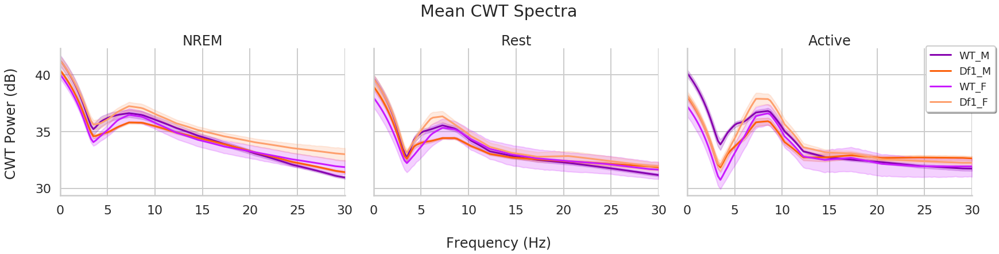

In [89]:
# Plot spectrograms for groups in the balanced sample set
group = 'geno_gender'
#for group in groups:
#    g = spec_plot(sampSetPivot,'CWT',group)
#    g.savefig(figure_dir+'Spectra/Spectra_'+group+'_withinSpec.svg',format='svg')
g2 = spec_plot(sampSetPlot,'CWT',group='state_name',hue=group,nBoot=5000)
#    g2.savefig(figure_dir+'Spectra/Spectra_'+group+'_betweenSpec.svg',format='svg')

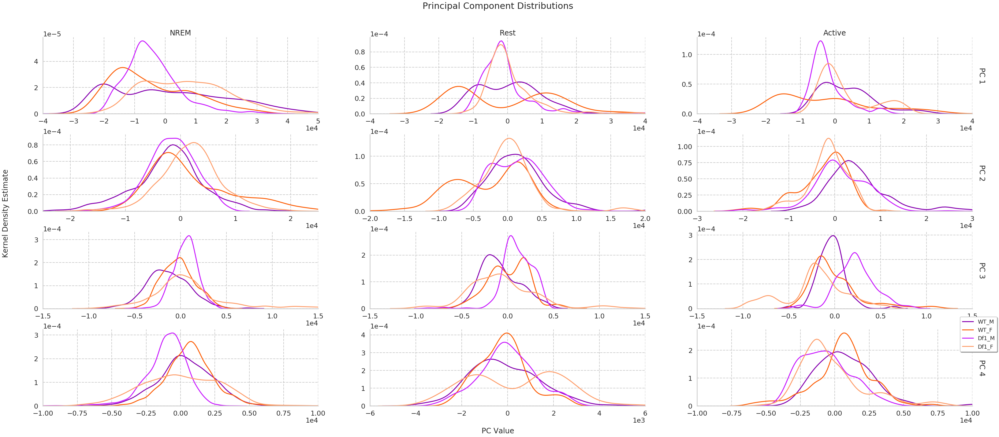

In [156]:
PCs = ['PC 1','PC 2','PC 3','PC 4']
plotPCA = pcaDat.melt(id_vars=['genotype','geno_gender','state_name'],value_vars=PCs,var_name='PC',value_name='Value')
g = sns.FacetGrid(data=plotPCA,col='state_name',row='PC',row_order=PCs,
                  col_order=groupOrders['state_name'],hue='geno_gender',margin_titles=True,palette=palDict['geno_gender'],
                 height=5,aspect=3,sharey=False,sharex=False)
g = g.map(sns.distplot,'Value',hist=False,norm_hist=False)
plt.subplots_adjust(top=.9)
g.fig.suptitle('Principal Component Distributions')
[plt.setp(ax.texts, text="") for ax in g.axes.flat]
g.set_titles(row_template='{row_name}', col_template='{col_name}')
g.set_axis_labels('','')
g.fig.text(0.5,0,'PC Value',ha='center',fontsize=24)
g.fig.text(0,.5,'Kernel Density Estimate',rotation=90,va='center',fontsize=24)
legend = plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1.2),
                    ncol=1, fancybox=True, shadow=True,fontsize=18)
g.despine()
form = matplotlib.ticker.ScalarFormatter()
form.set_powerlimits((-2,2))
lims = [(-40000,50000),(-40000,40000),(-40000,40000),(-25000,25000),(-20000,20000),(-30000,30000),
        (-15000,15000),(-15000,15000),(-15000,15000),(-10000,10000),(-6000,6000),(-10000,10000)]
i=0
for ax in g.axes.flat:
    ax.set_xlim(lims[i])
    ax.xaxis.set_major_formatter(form)
    ax.yaxis.set_major_formatter(form)
    i+=1
#g.savefig(figure_dir+'PCA/PC_Distributions.svg',format='svg')

In [50]:
# equally sample across groups
def eq_sample(df,group,total_sample_size):
    nrows = len(df)
    df = df.groupby(group).\
            apply(lambda x: x.sample(int((x.count().unique()[0]/nrows)*total_sample_size)))
    return df

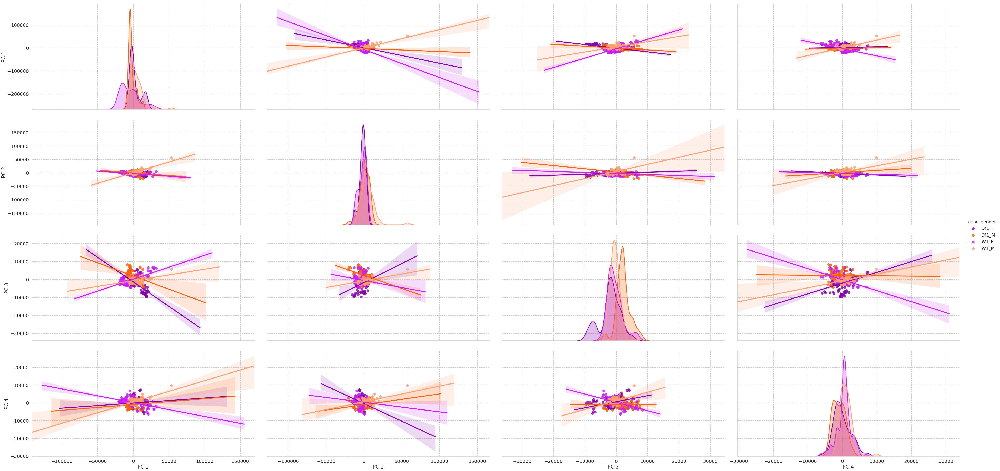

In [65]:
state='Active'
df = eq_sample(pcaDat.query('state_name=="'+state+'"'),'geno_gender',500)
sns.pairplot(data=df,vars=PCs,kind='reg',hue='geno_gender',palette=palDict['geno_gender'],height=8,aspect=2)